# **<font size="7">` Dependencies (must to run)`</font>**

___

In [1]:
import sys, os
if sys.platform == 'darwin' :
    os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
'main root'

main_path = os.path.abspath('../')
ds_root_path =  os.path.join(os.path.abspath('../..'),"ML_DataSet")
sys.path.append(main_path)
from lib.utils.common import is_path_available
from lib.visualization import Vis_PoseSampleTransform

'basic info'
print(" tensorflow version:",tf.__version__)
print(" numpy version:", np.__version__)
print(" Python version:", sys.version)
print(" sys.platform:", sys.platform)
print(" gpu available:", tf.config.list_physical_devices('GPU'))
print(" sys.path:", sys.path)
is_path_available(ds_root_path)
is_path_available(main_path) 

if  sys.platform == 'win32':
    'xla issue : https://www.qiniu.com/qfans/qnso-68614547#comments'
    #libdevice_path = "C:/Users/yista/anaconda3/envs/rtx_py38_tf2-10_cu118/Library/bin"
    #os.environ['XLA_FLAGS'] = "--xla_gpu_cuda_data_dir=C:/Users/yista/anaconda3/envs/rtx_py38_tf2-10_cu118/Library/bin"
    libdevice_path = "C:/Users/yista/anaconda3/envs/rtx_py38_tf2-10_cu118/Library/bin"
    is_path_available(libdevice_path)
    os.environ['XLA_FLAGS'] = "--xla_gpu_cuda_data_dir="+libdevice_path
    print(os.environ['XLA_FLAGS'])

key : BBoxesFormatTransform, value :<class 'lib.datasets.transforms.bboxes_format_transform.BBoxesFormatTransform'> >
key : ImageResize, value :<class 'lib.datasets.transforms.img_resize.ImageResize'> >
key : RandomPadImageResize, value :<class 'lib.datasets.transforms.img_resize.RandomPadImageResize'> >
key : Albumentations, value :<class 'lib.datasets.transforms.albumentations.Albumentations'> >
key : IdendityTest, value :<class 'lib.datasets.transforms.idendity_test.IdendityTest'> >
key : EnsureTensor, value :<class 'lib.datasets.transforms.ensure_to_tensor.EnsureTensor'> >
key : ImageNormalize, value :<class 'lib.datasets.transforms.img_norm.ImageNormalize'> >
key : RandomBBoxTransform, value :<class 'lib.datasets.transforms.random_bbox_transform.RandomBBoxTransform'> >
key : RandomFlip, value :<class 'lib.datasets.transforms.random_flip.RandomFlip'> >
key : RandomChannelShift, value :<class 'lib.datasets.transforms.random_channel_shift.RandomChannelShift'> >
key : RandomContrast, 

c:\Users\yista\anaconda3\envs\rtx_py38_tf2-10_cu118\lib\site-packages\tensorflow_addons\utils\tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


 gpu available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
 sys.path: ['h:\\deep_learning\\project_sample_V0.7.1\\tasks', 'c:\\Users\\yista\\anaconda3\\envs\\rtx_py38_tf2-10_cu118\\python38.zip', 'c:\\Users\\yista\\anaconda3\\envs\\rtx_py38_tf2-10_cu118\\DLLs', 'c:\\Users\\yista\\anaconda3\\envs\\rtx_py38_tf2-10_cu118\\lib', 'c:\\Users\\yista\\anaconda3\\envs\\rtx_py38_tf2-10_cu118', '', 'C:\\Users\\yista\\AppData\\Roaming\\Python\\Python38\\site-packages', 'c:\\Users\\yista\\anaconda3\\envs\\rtx_py38_tf2-10_cu118\\lib\\site-packages', 'c:\\Users\\yista\\anaconda3\\envs\\rtx_py38_tf2-10_cu118\\lib\\site-packages\\win32', 'c:\\Users\\yista\\anaconda3\\envs\\rtx_py38_tf2-10_cu118\\lib\\site-packages\\win32\\lib', 'c:\\Users\\yista\\anaconda3\\envs\\rtx_py38_tf2-10_cu118\\lib\\site-packages\\Pythonwin', 'h:\\deep_learning\\project_sample_V0.7.1']
successfully connect floder  : 
h:\deep_learning\ML_DataSet

successfully connect floder  : 
h:\deep_learning\project_sa

### **<font size="6">`HyperParams`</font>**

In [2]:
'MODEL Type'
MODEL_TYPE = 'mvla_pose'
PROJECT_NAME = 'HRNet'
MODEL_INPUT_SIZE_HW = (256,192)
MODEL_INPUT_SIZE_WH = MODEL_INPUT_SIZE_HW[::-1]
NUM_POSE_KPS = 17 

'Global Settings'
USE_MIXED_PRECISION = True
BATCH_SIZE = 32
PREFETCH_SIZE = 4
BATCH_NORM_EPSILON = 1e-5  #torch  :  bn_eps = 1e-5,  tensorflow : bn_eps = 1e-3
BATCH_NORM_MOMENTUM = 0.9  #torch  :  bn_moentum = 0.9,  tensorflow : bn_moentum = 0.99
CODEC_PARALLEL_ITERS = 32  #parallel_iterations
CV_TRANS_PARALLEL_ITERS = 32  #parallel_iterations
'Training'
TOTAL_EPOCHS = 200
WARMUP_EPOCHS = TOTAL_EPOCHS//10
LR = 1e-3



## **<font size="6">`Mixed Precision (Optional)`</font>**

In [3]:
from tensorflow.keras import mixed_precision
if USE_MIXED_PRECISION :
    policy = mixed_precision.Policy('mixed_float16')
else:
    policy = mixed_precision.Policy('float32')
mixed_precision.set_global_policy(policy)
print('Compute dtype: %s' % policy.compute_dtype)
print('Variable dtype: %s' % policy.variable_dtype)

INFO:tensorflow:Mixed precision compatibility check (mixed_float16): OK
Your GPU will likely run quickly with dtype policy mixed_float16 as it has compute capability of at least 7.0. Your GPU: NVIDIA GeForce RTX 3070 Laptop GPU, compute capability 8.6
Compute dtype: float16
Variable dtype: float32


In [4]:
'dataset root'
ds_main_path =  os.path.join(ds_root_path,"COCO-WholeBody")
is_path_available(ds_main_path)

'train/ val dataset path'
val_tfrec_kps_dir = os.path.join(ds_main_path, "tfrecords_kps_val")
'verify whether tfrecords_dir is exist'
is_path_available(val_tfrec_kps_dir)

'train/ val dataset path'
train_tfrec_kps_dir = os.path.join(ds_main_path, "tfrecords_kps_train")
'verify whether tfrecords_dir is exist'
is_path_available(train_tfrec_kps_dir)


'pretrained model lib'
#lib_main_path =  os.path.join(os.path.abspath('../..'),"trained")
lib_main_path = os.path.join(
    os.path.abspath('../..'), "trained", MODEL_TYPE, PROJECT_NAME
)
is_path_available(lib_main_path)



successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody

successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val

successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train

successfully connect floder  : 
h:\deep_learning\trained\mvla_pose\HRNet



True

# **<font size="7">` 1. Build DataLoader`</font>**

### **<font size="6">`Explore loaded samples from  pasrsed TFRecData`</font>**

## **<font size="6">`1-1. Train data pipeline `</font>**

register : <tfds_pipeline>  init ...................from internal libs


 All Modules of registry < tfds_pipeline >have been automatically imported from lib.datasets

--------------register : <tfds_pipeline>  Update Done-----from internal libs

successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train

samples_in_tfrec : 4269 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train\file_00-4269.tfrec>
samples_in_tfrec : 2899 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train\file_01-2899.tfrec>
samples_in_tfrec : 3523 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train\file_02-3523.tfrec>
samples_in_tfrec : 4124 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train\file_03-4124.tfrec>
samples_in_tfrec : 4701 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train\file_04-4701.tfrec>
samples_in_tfrec : 5047 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train\file_05-5047.tfrec>

h:\deep_learning\project_sample_V0.7.1\lib\datasets\tfds_builder.py:93: UserWarning: codec is None, you cannot gen targets used in traaining, but test_mode to review data is ok @pose_dataloader
  warnings.warn(


register : <transforms>  init ...................from internal libs


 All Modules of registry < transforms >have been automatically imported from lib.datasets.transforms

--------------register : <transforms>  Update Done-----from internal libs


 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- RandomFlip : <lib.datasets.transforms.random_flip.RandomFlip object at 0x000001E406A21430>
< 2 >  --- RandomHalfBody : <lib.datasets.transforms.random_half_body.RandomHalfBody object at 0x000001E406A21EE0>
< 3 >  --- RandomBBoxTransform : <lib.datasets.transforms.random_bbox_transform.RandomBBoxTransform object at 0x000001E406A214C0>
< 4 >  --- RandomKPSDropout : <lib.datasets.transforms.random_kps_dropout.RandomKPSDropout object at 0x000001E406A21490>
< 5 >  --- RandomGaussianBlur : <lib.datasets.transforms.random_gaussian_blur.RandomGaussianBlur object at 0x000001E406A21520>
< 6 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownA

h:\deep_learning\project_sample_V0.7.1\lib\datasets\tfds_builder.py:289: UserWarning: test_mode cannot support training !!!!!!!!!! @pose_dataloader
  warnings.warn("test_mode cannot support training !!!!!!!!!! @pose_dataloader")



 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomFlip : <lib.datasets.transforms.random_flip.RandomFlip object at 0x000001E406A21430>
< 2 >  --- RandomHalfBody : <lib.datasets.transforms.random_half_body.RandomHalfBody object at 0x000001E406A21EE0>
< 3 >  --- RandomBBoxTransform : <lib.datasets.transforms.random_bbox_transform.RandomBBoxTransform object at 0x000001E406A214C0>
< 4 >  --- RandomKPSDropout : <lib.datasets.transforms.random_kps_dropout.RandomKPSDropout object at 0x000001E406A21490>
< 5 >  --- RandomGaussianBlur : <lib.datasets.transforms.random_gaussian_blur.RandomGaussianBlur object at 0x000001E406A21520>
< 6 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x000001E406A21070>
< 7 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTensor object at 0x000001E40677EF70>
< 8 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 

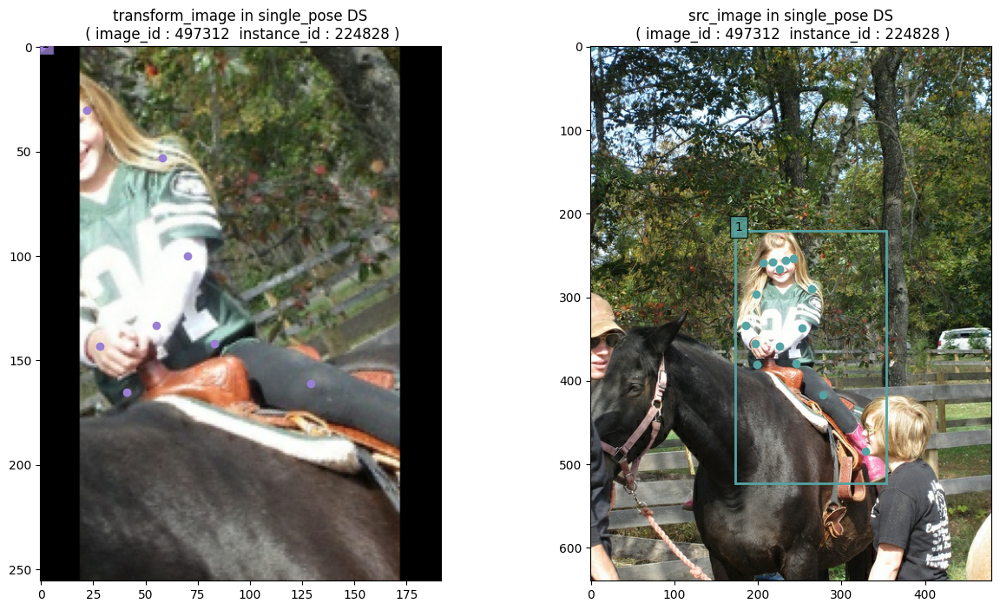

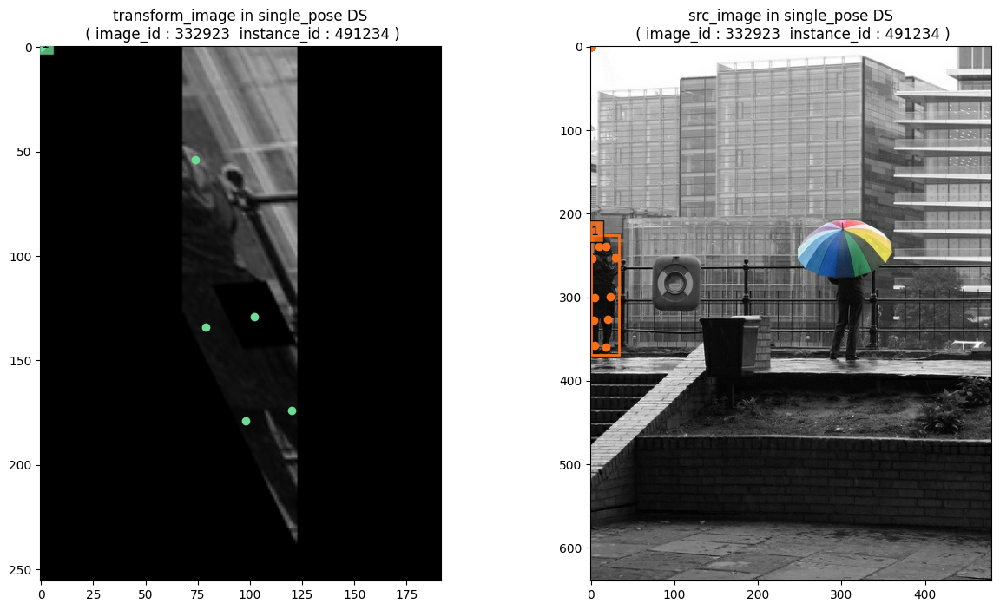

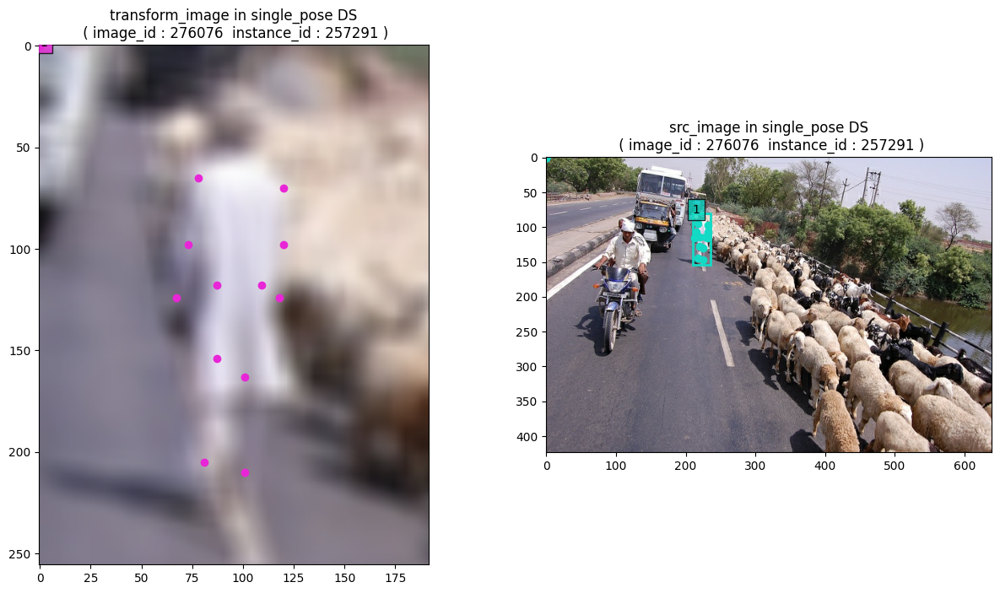

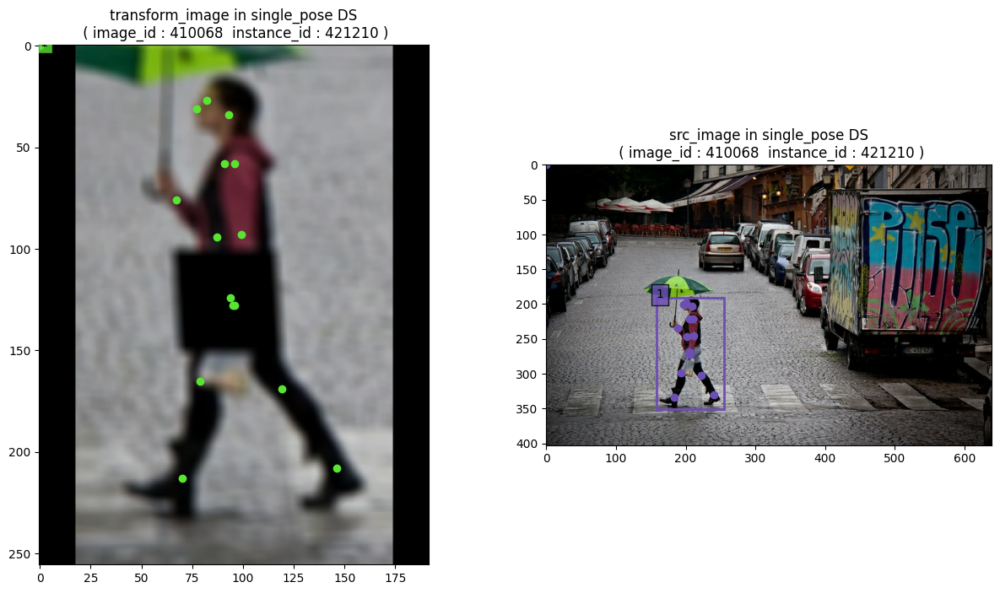

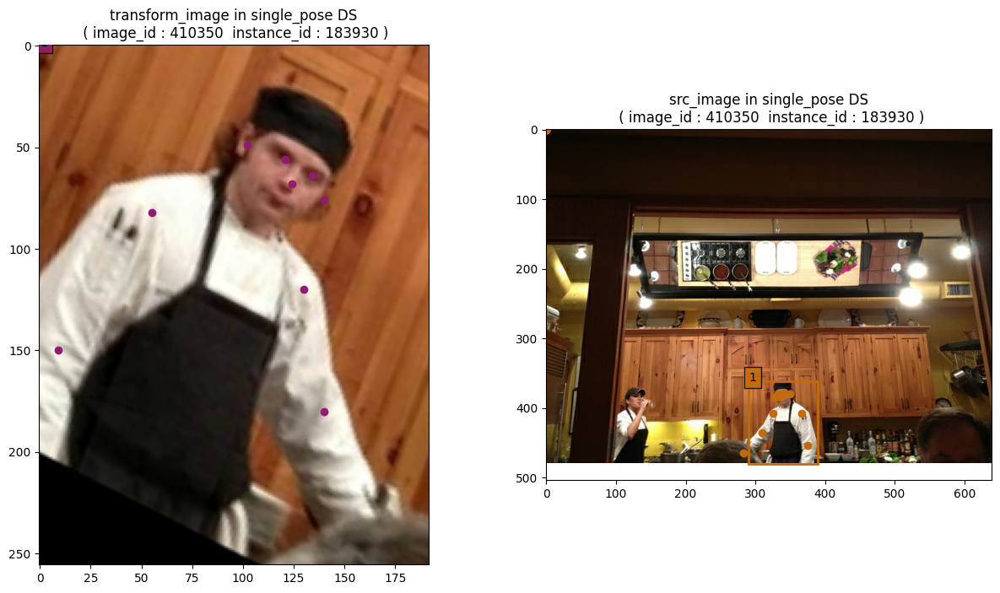

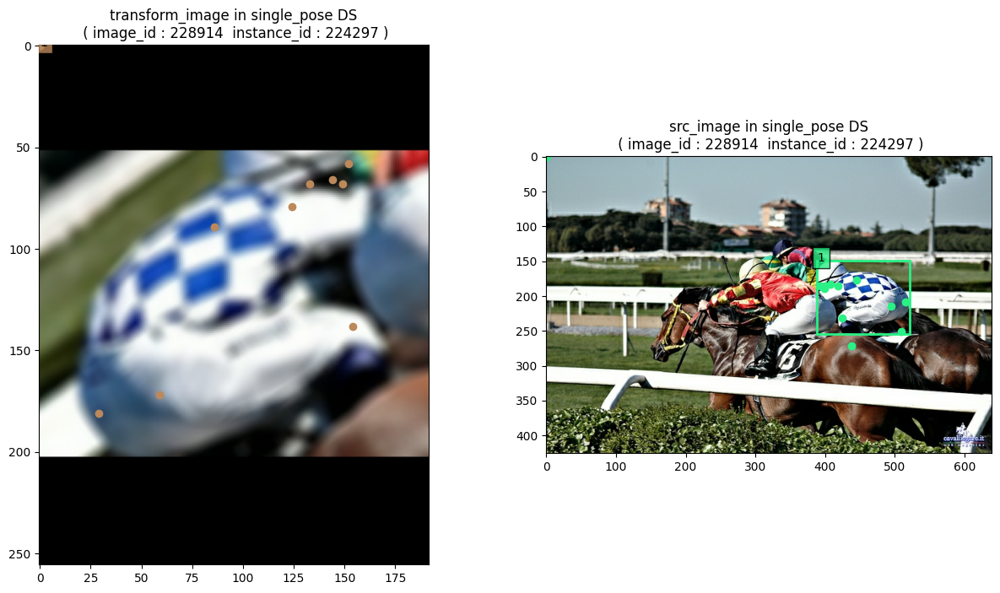

In [5]:
import copy
from lib.Registers import DATASETS
from lib.datasets.transforms import PackInputTensorTypeSpec

'#0 train / val dataset path'
tfrec_train_dataset_cfg = dict(
    type = 'BaseCocoStyleDataset_Parser', 
    data_root = train_tfrec_kps_dir,
)
tfrec_train_dataset_cfg = dict(
    type = 'Parser_CocoSinglePoseTFRec_CocoPoseStyle', 
    data_root = train_tfrec_kps_dir,
)
IdendityTest_cfg = dict(type='IdendityTest')

flip_cfg = dict(
    type='RandomFlip',
    prob=0.5
)
halfbody_cfg = dict(
    type='RandomHalfBody',
    prob=0.5, 
    upper_prioritized_prob= 0.7,
    padding = 1.5,
    min_total_keypoints = 9, 
    min_upper_keypoints = 4,
    min_lower_keypoints = 4
)
bbox_cfg = dict(
    type='RandomBBoxTransform',  
    shift_factor = 0.16, 
    shift_prob = 0.5, 
    scale_factor = (0.75, 1.25), 
    scale_prob = 0.5 ,
)
contrast_cfg = dict(
    type = 'RandomContrast',
    value_range =(0,255), 
    factor =(0.3, 0.8),
    prob = 0.5,
    test_mode=False
)
hsv_cfg = dict(
    type='RandomHSVAug',  
    hue_prob = 0.5,
    saturation_prob = 0.5,
    brightness_prob = 0.5,
    hue_delta = 0.3, 
    saturation_factor = (0.5,2.0),
    brightness_delta = 0.4
)
blur_cfg = dict(type='RandomGaussianBlur', 
                kernel_size_xy=(5,5),
                factor=3.0,
                prob =0.5,
                test_mode=True
)
kpsdrop_cfg = dict(
    type='RandomKPSDropout',   
    base_mask_ratio = 0.05,
    mask_scale_factor = (0.8, 1.2),
    min_bbox_area = 64.*64.,
    prob=0.5, 
    drop_joints_indices=[5,6,7,8,11,12],
    random_mask_color=False, 
    test_mode =False
)
affine_cfg = dict(
    type='TopdownAffine',
    target_image_size_yx = MODEL_INPUT_SIZE_HW,
    interpolation  = "bilinear", 
    use_udp = True,
    is_train = True, 
    test_mode = False,   
    do_clip = True,      
    keep_bbox_aspect_prob = 0.5,
    rotate_prob = 0.5,
    shear_prob = 0.25,
    MaxRot_deg=30., 
    MaxShear_deg=15.
)

train_dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = BATCH_SIZE,
    prefetch_size = PREFETCH_SIZE,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_train_dataset_cfg],
    augmenters = [flip_cfg, halfbody_cfg, bbox_cfg, kpsdrop_cfg, blur_cfg, affine_cfg],
    codec = None,
    ensure_to_tensor = True,
    parallel_iterations = CV_TRANS_PARALLEL_ITERS,
    vis_fn = Vis_PoseSampleTransform
)
train_tfds_builder = DATASETS.build(
    copy.deepcopy(train_dataloader_cfg)
)
batch_train_dataset = train_tfds_builder.GenerateTargets(
    test_mode=False, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None
)
train_tfds_builder.get_pipeline_cfg() 
# Vis_PoseSampleTopdownAffine(
#     samples = next(iter(batch_train_dataset)),   
#     batch_id  =0,
# )
train_tfds_builder.explore_samples(
    take_batch_num = 2,
    batch_ids  = [0,1,2],
    plot_transformed_bbox=False,
    figsize = (15,8)
)

## **<font size="6">`1-2. Val data pipeline`</font>**

successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val

samples_in_tfrec : 1880 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val\file_00-1880.tfrec>
samples_in_tfrec : 2425 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val\file_01-2425.tfrec>
samples_in_tfrec : 1342 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val\file_02-1342.tfrec>
num_TotalSamples: 5647
successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x000001E6104C9FA0>
< 2 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTensor object at 0x000001E6104C9DF0>
< 3 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x000001E610445C10>
----------------------------------------

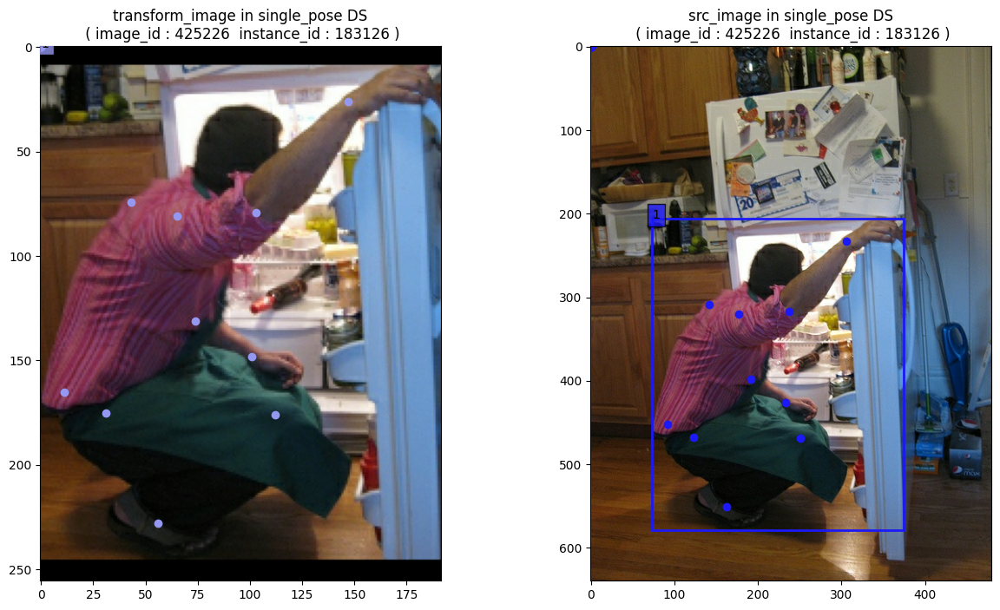

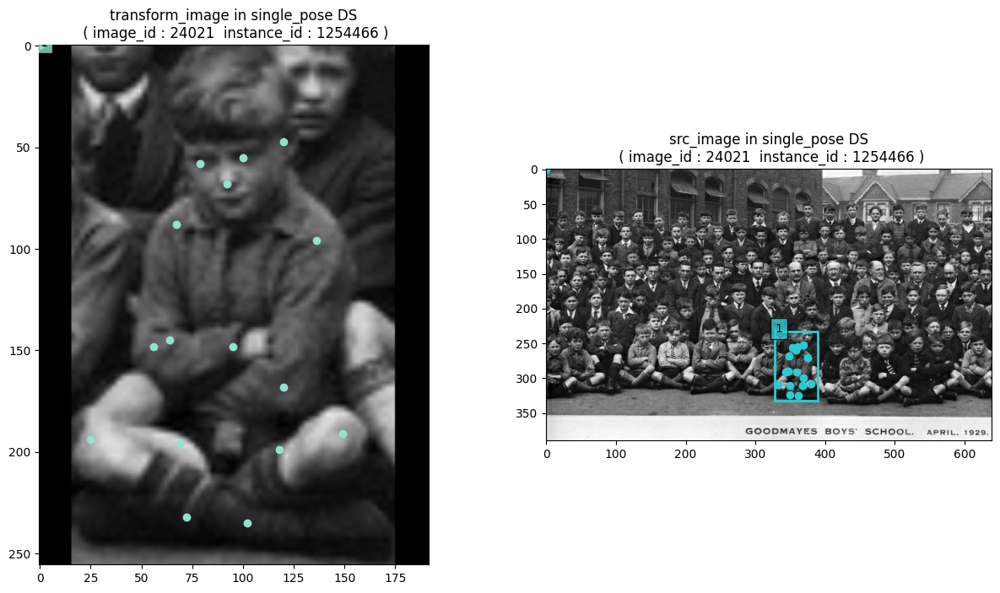

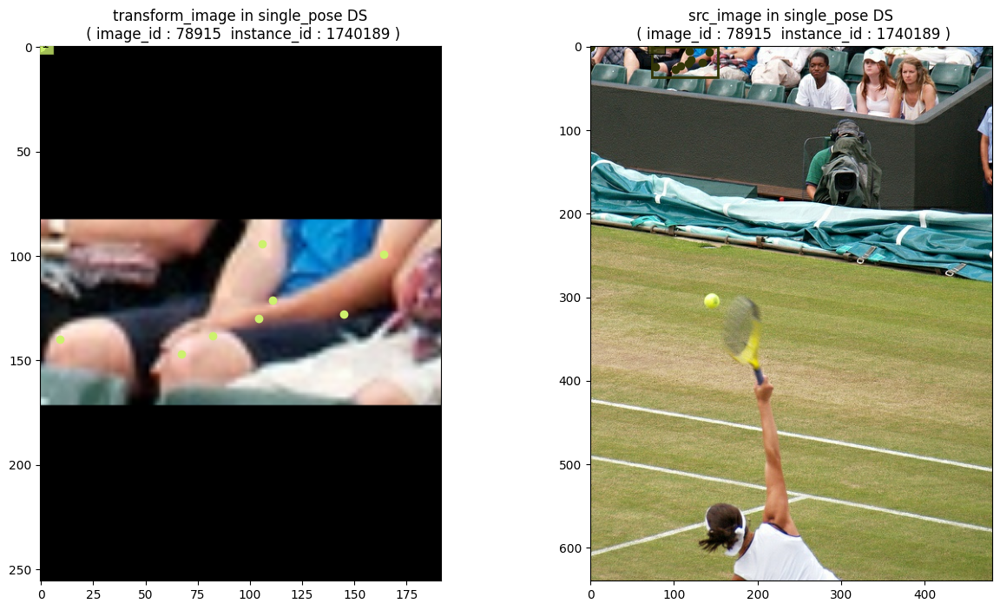

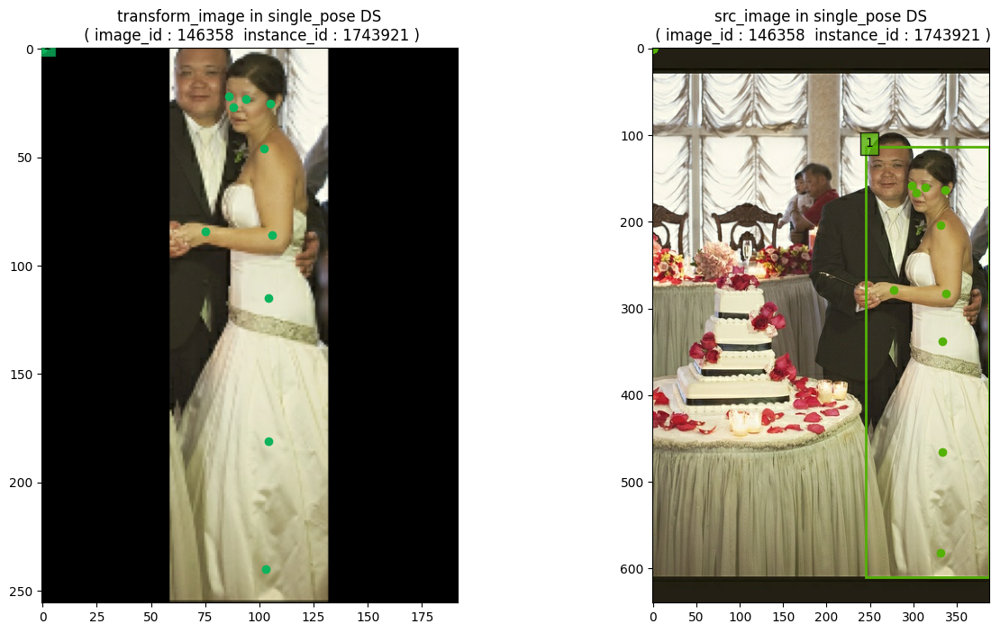

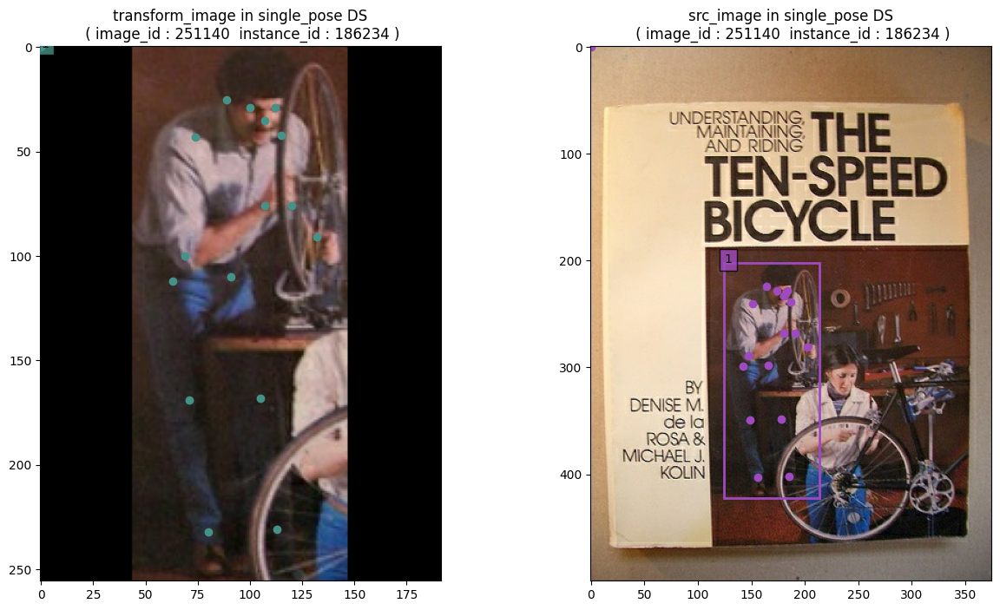

...

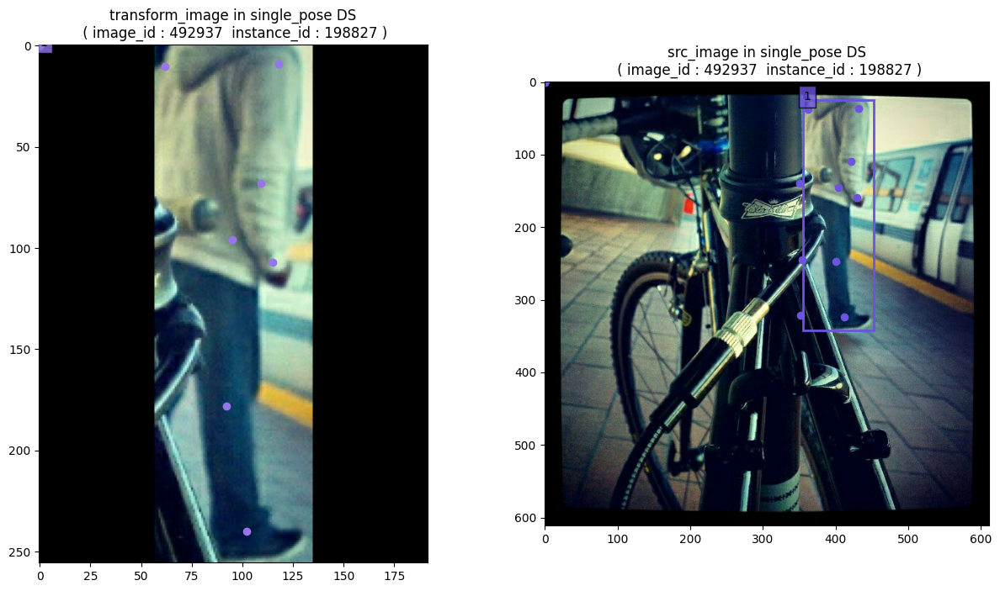

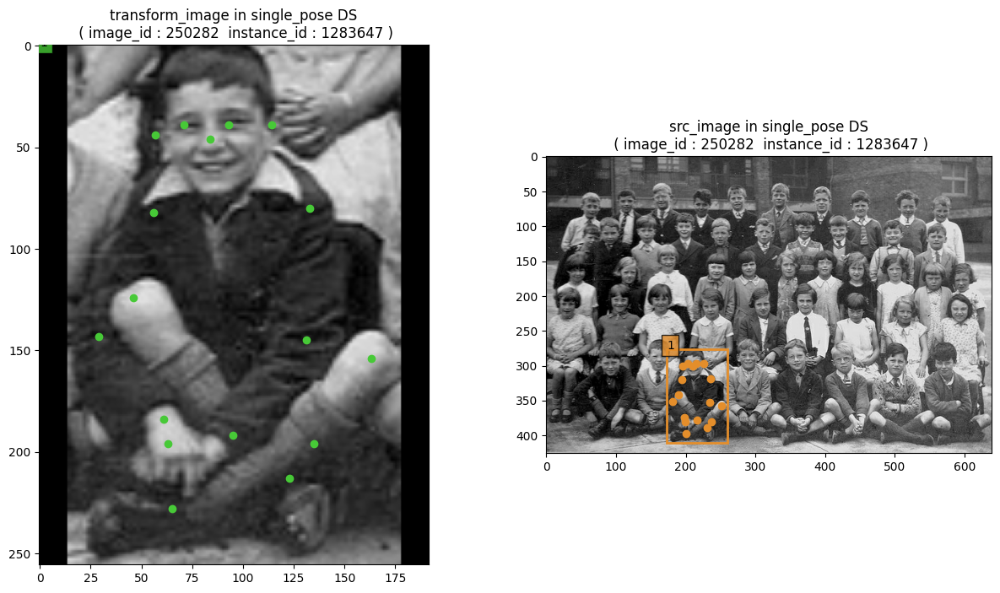

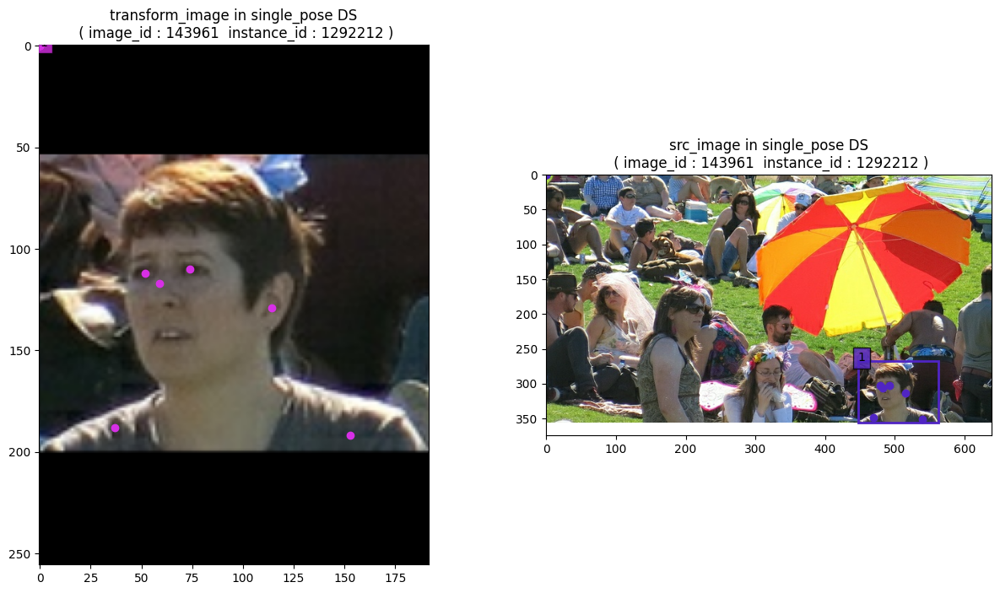

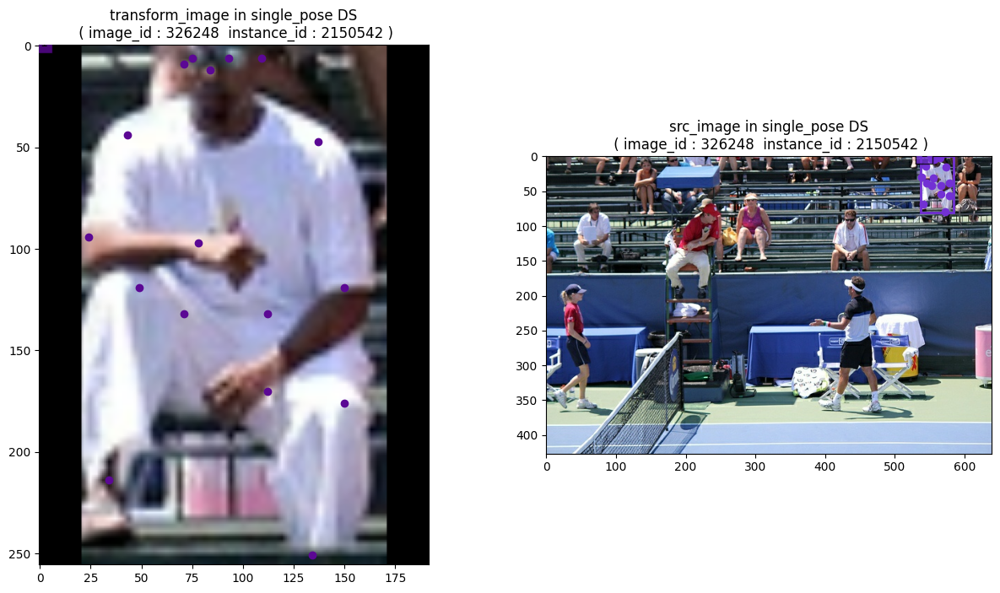

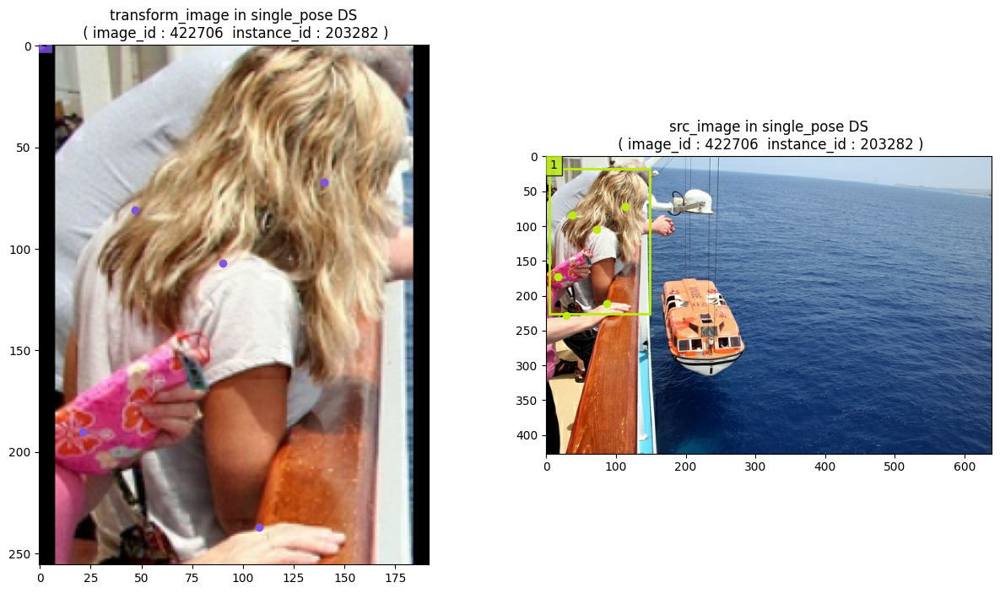

In [6]:
# tfrec_val_dataset_cfg = dict(
#     type = 'BaseCocoStyleDataset_Parser', 
#     data_root = val_tfrec_kps_dir,
# )

tfrec_val_dataset_cfg = dict(
    type = 'Parser_CocoSinglePoseTFRec_CocoPoseStyle', 
    data_root = val_tfrec_kps_dir,
)

val_affine_cfg = dict(
    type='TopdownAffine',
    is_train = False, 
    test_mode = False,   
    do_clip = True,      
    keep_bbox_aspect_prob = 1.,
    rotate_prob = 0.,
    shear_prob = 0.,
    MaxRot_deg=0., 
    MaxShear_deg=0.
)

val_dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = BATCH_SIZE,
    prefetch_size = PREFETCH_SIZE,
    shuffle  =  False,
    tfrec_datasets_list = [tfrec_val_dataset_cfg],
    augmenters = [val_affine_cfg],
    codec = None,
    ensure_to_tensor = True,
    vis_fn = Vis_PoseSampleTransform
)

val_tfds_builder = DATASETS.build(
    copy.deepcopy(val_dataloader_cfg)
)
batch_val_dataset = val_tfds_builder.GenerateTargets(
    test_mode=False,
    unpack_x_y_sample_weight= False, 
    ds_weights =None)

#val_tfds_builder.get_pipeline_cfg() 

val_tfds_builder.explore_samples(
    take_batch_num = 6,
    batch_ids  = [0,1,2],
    plot_transformed_bbox=False,
    figsize = (15,8)
)

# Vis_PoseSampleTopdownAffine(
#     samples = next(iter(batch_val_dataset)),   
#     batch_id  =0,
# )

# **<font size="7">` 2. Task Modeling`</font>**

## **<font size="6">` Backbone Test (optional)`</font>**

In [4]:
from lib.models.backbones import HRNet
model = HRNet(
    model_input_shape=(256,192),         
    num_modules = [1,1,4,3],
    num_blocks  = [4,4,4,4],
    branches_channels = [32,64,128,256],
    interpolation  = 'bilinear',
    psa_type = 'p',
    multiscale_output= False,
    data_preprocessor = None,
    activation = 'relu',
    bn_epsilon = 1e-5,
    bn_momentum = 0.9,
    name = "HRNetW32"
) 

a = tf.ones(shape=(32,256,192,3))
out = model.call(a)
print(out[0,0,0])
out = model(a)
print(out[0,0,0])



key : RelativePositionalEmbedding, value :<class 'lib.layers.transformers.rel_pos_embs.RelativePositionalEmbedding'> >
key : AddRelativePositionBiasT5, value :<class 'lib.layers.transformers.rel_pos_embs.AddRelativePositionBiasT5'> >
key : RotaryPositionEmbedding, value :<class 'lib.layers.transformers.rope.RotaryPositionEmbedding'> >
key : GatedAttentionUnit, value :<class 'lib.layers.transformers.gau.GatedAttentionUnit'> >
key : ImgNormalization, value :<class 'lib.layers.pre_processors.img_norm.ImgNormalization'> >
key : ViT, value :<class 'lib.models.backbones.vit.ViT'> >
key : ResidualStepsBlock, value :<class 'lib.models.modules.rsb.ResidualStepsBlock'> >
key : CSPNeXt, value :<class 'lib.models.backbones.cspnext.CSPNeXt'> >
key : CSPNeXt_L, value :<function CSPNeXt_L at 0x000002B09526FAF0> >
key : CSPNeXt_M, value :<function CSPNeXt_M at 0x000002B095286DC0> >
key : CSPNeXt_S, value :<function CSPNeXt_S at 0x000002B095286E50> >
key : CSPNeXt_Tiny, value :<function CSPNeXt_Tiny at

## **<font size="6">` Codec Test (optional)`</font>**

In [9]:
from lib.models import BaseModel
from lib.Registers import CODECS
codec_cfg = dict(   
    type = 'MSRAHeatmapCodec',
    use_udp = True, 
    num_kps = 17,
    sigma = 2,
    target_size_xy = (192,256),
    heatmap_size_xy = (48, 64),
    hm_thr= tf.zeros(shape=(17,), dtype=tf.float32),
    use_vectorized_map  = False,
    parallel_iterations  = CODEC_PARALLEL_ITERS,
)

CODECS.build(codec_cfg)

(13, 13, 2) (2,)


## **<font size="6">`Build Model`</font>**

In [5]:
from lib.metrics import PCKMetric

key : PCKMetric, value :<class 'lib.metrics.pose_metrics.PCKMetric'> >
key : SimCC_PCKMetric, value :<class 'lib.metrics.pose_metrics.SimCC_PCKMetric'> >


In [7]:
from lib.Registers import MODELS
from lib.models import BaseModel
hrnet_backbone_cfg = dict(
        type ='HRNet',
        model_input_shape=(256,192),         
        num_modules = [1,1,4,3],
        num_blocks  = [4,4,4,4],
        branches_channels = [32,64,128,256],
        interpolation  = 'bilinear',
        psa_type = None,
        multiscale_output= False,
        data_preprocessor = dict(
            type='ImgNormalization', 
            img_mean = [0.485, 0.456, 0.406],  
            img_std = [0.229, 0.224, 0.225]
        ),
        activation = 'relu',
        bn_epsilon = BATCH_NORM_EPSILON,
        bn_momentum = BATCH_NORM_MOMENTUM,
        name = "HRNetW32",
        deploy = False
)   


heatmap_head_cfg = dict(
    type ='HeatmapBaseHead',
    out_channels = 17,
    deconv_filters_list =[], 
    deconv_kernels_list = [],
    conv_kernel_szie=None,
    conv_out_channels= None,
    bn_epsilon = BATCH_NORM_EPSILON,
    bn_momentum = BATCH_NORM_MOMENTUM,
)   


Optimzer_cfg = dict(
    type="Adam", 
    learning_rate=LR,
)

Loss_cfg_list = [  
    dict(
        type = 'KeypointsMSELoss',
        joints_balance_weights = [
            1., 1., 1., 1., 1., 1., 1., 1.2, 1.2,
            1.5, 1.5, 1., 1., 1.2, 1.2, 1.5, 1.5
        ],
        loss_weight = 1.0                          
    ) 
]

metric_cfg_dict =  [ 
    dict(
        type = 'PCKMetric',
        tf_dists = 0.5, 
        num_kps = 17,
        hm_thr= [
            0.75, 0.75, 0.75, 0.75, 0.75,
            0.25, 0.25, 0.25, 0.25, 0.25,
            0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25
        ]            
    )
]

codec_cfg = dict(   
    type = 'MSRAHeatmapCodec',
    use_udp = True, 
    num_kps = 17,
    sigma = 2,
    target_size_xy = (192,256),
    heatmap_size_xy = (48, 64),
    hm_thr= tf.concat(
        [
            tf.ones(shape=(5,), dtype=tf.float32)*0.75, 
            tf.ones(shape=(12,), dtype=tf.float32)*0.5
        ], 
        axis=-1
    ),
    use_vectorized_map  = False,
    parallel_iterations  = CODEC_PARALLEL_ITERS,
)

model = BaseModel(
    backbone = hrnet_backbone_cfg,
    neck  = None,
    head  = heatmap_head_cfg,
    extract_layres = [],
    codec = codec_cfg,
    optimizer = Optimzer_cfg,  # optimizer
    losses  = Loss_cfg_list,
    metrics  = metric_cfg_dict, 
    jit_compile = False,
    name = 'HRNetPose_W32'
)

model.output       

key : RelativePositionalEmbedding, value :<class 'lib.layers.transformers.rel_pos_embs.RelativePositionalEmbedding'> >
key : AddRelativePositionBiasT5, value :<class 'lib.layers.transformers.rel_pos_embs.AddRelativePositionBiasT5'> >
key : RotaryPositionEmbedding, value :<class 'lib.layers.transformers.rope.RotaryPositionEmbedding'> >
key : GatedAttentionUnit, value :<class 'lib.layers.transformers.gau.GatedAttentionUnit'> >
key : ImgNormalization, value :<class 'lib.layers.pre_processors.img_norm.ImgNormalization'> >
key : ViT, value :<class 'lib.models.backbones.vit.ViT'> >
key : ResidualStepsBlock, value :<class 'lib.models.modules.rsb.ResidualStepsBlock'> >
key : CSPNeXt, value :<class 'lib.models.backbones.cspnext.CSPNeXt'> >
key : CSPNeXt_L, value :<function CSPNeXt_L at 0x000001E6164B9C10> >
key : CSPNeXt_M, value :<function CSPNeXt_M at 0x000001E6164D3040> >
key : CSPNeXt_S, value :<function CSPNeXt_S at 0x000001E6164D30D0> >
key : CSPNeXt_Tiny, value :<function CSPNeXt_Tiny at

<KerasTensor: shape=(None, 64, 48, 17) dtype=float32 (created by layer 'HeatmapBaseHead_pwConv_OUT')>

In [ ]:
model.summary(200)

### **<font size="5">` Load Model Weights`</font>**

In [8]:
h5_file_name = 'td-hm_HRNet-w32_udp-b128-220e_coco-256x192_EMA.h5'
file_path = os.path.join(
    lib_main_path, h5_file_name
)
is_path_available(file_path)
model.load_weights(file_path,skip_mismatch=False,by_name=True)


successfully connect floder  : 
h:\deep_learning\trained\mvla_pose\HRNet\td-hm_HRNet-w32_udp-b128-220e_coco-256x192_EMA.h5



### **<font size="5">` Mini Training Test (Optional)`</font>**

In [8]:
history = model.fit(
    batch_train_dataset, 
    epochs = 5, 
    steps_per_epoch = 4,
    validation_data = batch_val_dataset,
    validation_steps = 2,
)


init ModelingTask ..............
Epoch 1/5
4/4 [==============================] - 64s 3s/step - loss: 13.9534 - pck_acc: 0.0000e+00 - val_loss: 13.8198 - val_pck_acc: 0.0000e+00
Epoch 2/5
4/4 [==============================] - 5s 1s/step - loss: 4.3319 - pck_acc: 0.0000e+00 - val_loss: 3.7969 - val_pck_acc: 0.0000e+00
Epoch 3/5
4/4 [==============================] - 4s 1s/step - loss: 0.7815 - pck_acc: 0.0000e+00 - val_loss: 1.8059 - val_pck_acc: 0.0000e+00
Epoch 4/5
4/4 [==============================] - 4s 1s/step - loss: 0.4196 - pck_acc: 0.0000e+00 - val_loss: 3.0462 - val_pck_acc: 0.0000e+00
Epoch 5/5
4/4 [==============================] - 4s 1s/step - loss: 0.1695 - pck_acc: 0.0000e+00 - val_loss: 3.3201 - val_pck_acc: 0.0000e+00


# **<font size="7">` 3. Model Training`</font>**

## **<font size="6">` Callbacks`</font>**

In [11]:
from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard, EarlyStopping, ReduceLROnPlateau
from lib.callbacks import CosineDecayScheduler, EMA_ModelCheckpoint


train_steps_per_epoch = train_tfds_builder.ds_steps_per_epoch
val_steps_per_epoch = val_tfds_builder.ds_steps_per_epoch
STEPS_PER_EPOCH = train_steps_per_epoch

ema_h5_file_name = 'td-hm_HRNet-w32_udp-b64-200e_coco-256x192_EMA.h5'
h5_file_name = 'td-hm_HRNet-w32_udp-b64-200e_coco-256x192.h5'
ema_file_path = os.path.join(lib_main_path, ema_h5_file_name)
file_path = os.path.join(lib_main_path,h5_file_name)


callbacks = [
    EarlyStopping(
        monitor = 'pckval_acc',  # "val_loss"
        patience=20
    ),
    EMA_ModelCheckpoint(
        ema_file_path,
        decay = 0.999, 
        val_use_ema_weights = True,
        verbose=1
    ) ,
    # ModelCheckpoint(
    #     filepath = file_path,
    #     monitor="loss",
    #     verbose=1,
    #     save_best_only=True,
    #     save_weights_only=True
    # ),
    CosineDecayScheduler(
        learning_rate  = LR,
        alpha = 0.,
        total_epochs = TOTAL_EPOCHS,
        steps_per_epoch = STEPS_PER_EPOCH,
        warmup_steps = STEPS_PER_EPOCH*TOTAL_EPOCHS//10, # STEPS_PER_EPOCH*TOTAL_EPOCHS/10
        warmup_steps_update = 100,
        hold_epochs =20,
        base_decay_cycle_epochs = -1,
        t_mul=1.,
        m_mul=1.
    ) ,
    TensorBoard(
        log_dir='logs'
    ),
]

### **<font size="5">` lr test (option)`</font>**

In [9]:
train_steps_per_epoch = train_tfds_builder.ds_steps_per_epoch
val_steps_per_epoch = val_tfds_builder.ds_steps_per_epoch
from lib.callbacks import CosineDecayScheduler

#TOTAL_EPOCHS = 230     
#LR = 1e-3   
STEPS_PER_EPOCH = train_steps_per_epoch

lr_callback = CosineDecayScheduler(
    learning_rate  = LR,
    alpha = 0.,
    total_epochs = TOTAL_EPOCHS,
    steps_per_epoch = STEPS_PER_EPOCH,
    warmup_steps = STEPS_PER_EPOCH*TOTAL_EPOCHS//10, # STEPS_PER_EPOCH*TOTAL_EPOCHS/10
    warmup_steps_update = 100,
    hold_epochs =20,
    base_decay_cycle_epochs = -1,
    t_mul=1.,
    m_mul=1.
) 
lr_callback.test()

NameError: name 'val_tfds_builder' is not defined

### **<font size="5">`EMA Test(optional)`</font>**

In [8]:
from lib.callbacks import EMA_ModelCheckpoint
from tensorflow.keras.callbacks import ModelCheckpoint      
model_type= 'mvla_pose'
project_name = 'HRNet'
ema_h5_file_name = 'td-hm_HRNet-w32_udp-b64-200e_coco-256x192_EMA_Test.h5'
h5_file_name = 'td-hm_HRNet-w32_udp-b64-200e_coco-256x192_Test.h5'

ema_file_path = os.path.join(lib_main_path, ema_h5_file_name)
file_path = os.path.join(lib_main_path, h5_file_name)

chekpoint = ModelCheckpoint(
    filepath = file_path,
    monitor="loss",
    verbose=1,
    save_best_only=False,
    save_weights_only=True
)

ema_chekpoint = EMA_ModelCheckpoint(
    ema_file_path,
    decay = 0.999, 
    val_use_ema_weights = True,
    verbose=1
)    

callbacks = [ema_chekpoint, chekpoint]
        
history = model.fit(
    batch_train_dataset, 
    epochs = 5, 
    steps_per_epoch = 4,
    validation_data = batch_val_dataset,
    validation_steps = 2,
    callbacks=callbacks
)



init ModelingTask ..............
apply ExponentialMovingAverage...............
Instructions for updating:
Use Variable.read_value. Variables in 2.X are initialized automatically both in eager and graph (inside tf.defun) contexts.
Epoch 1/5
4/4 [==============================] - ETA: 0s - loss: 14.0619 - pck_acc: 0.0000e+00
Epoch 1: saving model to h:\deep_learning\trained\mvla_pose\HRNet\td-hm_HRNet-w32_udp-b64-200e_coco-256x192_EMA_Test.h5

Epoch 1: saving model to h:\deep_learning\trained\mvla_pose\HRNet\td-hm_HRNet-w32_udp-b64-200e_coco-256x192_Test.h5
4/4 [==============================] - 64s 4s/step - loss: 14.0619 - pck_acc: 0.0000e+00 - val_loss: 16.5748 - val_pck_acc: 0.0000e+00
Epoch 2/5
4/4 [==============================] - ETA: 0s - loss: 5.9159 - pck_acc: 0.0000e+00
Epoch 2: saving model to h:\deep_learning\trained\mvla_pose\HRNet\td-hm_HRNet-w32_udp-b64-200e_coco-256x192_EMA_Test.h5

Epoch 2: saving model to h:\deep_learning\trained\mvla_pose\HRNet\td-hm_HRNet-w32_udp-b6

In [ ]:
model.load_weights(file_path,skip_mismatch=True,by_name=True)
ema_new = tf.train.ExponentialMovingAverage(decay=0.1, name='ema')
ema_new.apply(model.trainable_variables)
print(model.trainable_variables[0][0,0,0,:10])
#print(model.trainable_weights[0][0,0,0,:10])
var = model.trainable_variables[0]
var.assign(tf.ones(shape=(3,3,3,64)))
print(model.trainable_variables[0][0,0,0,:10])
ema_new.apply(model.trainable_variables)
print(ema_new.average(model.trainable_variables[0])[0,0,0,:10])
print(model.trainable_variables[0][0,0,0,:10])

## **<font size="6">` Training`</font>**


In [ ]:
history = model.fit(
    batch_train_dataset, 
    epochs = 200, 
    steps_per_epoch = train_steps_per_epoch,
    validation_data = batch_val_dataset,
    validation_steps = val_steps_per_epoch,
    callbacks=callbacks
)

### **<font size="5">` Mini Training Test (Optional)`</font>**

In [11]:

#callbacks = []
history = model.fit(
    batch_train_dataset, 
    epochs = 5, 
    steps_per_epoch = 4,
)

# history = model.fit(
#     batch_train_dataset, 
#     epochs = 5, 
#     steps_per_epoch = 4,
#     validation_data = batch_val_dataset,
#     validation_steps = 2,
# )


init ModelingTask ..............
Epoch 1/5
4/4 [==============================] - 55s 608ms/step - loss: 13.3080 - pck_acc: 0.0000e+00
Epoch 2/5
4/4 [==============================] - 2s 578ms/step - loss: 4.9438 - pck_acc: 0.0000e+00
Epoch 3/5
4/4 [==============================] - 2s 553ms/step - loss: 0.7268 - pck_acc: 0.0390
Epoch 4/5
4/4 [==============================] - 2s 559ms/step - loss: 0.4182 - pck_acc: 0.0000e+00
Epoch 5/5
4/4 [==============================] - 2s 571ms/step - loss: 0.1533 - pck_acc: 0.1053


# **<font size="7">` 3. Evaluation`</font>**

dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format'])
1/1 [==============================] - 0s 365ms/step
dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format'])
1/1 [==============================] - 0s 217ms/step
dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format'])
1/1 [==============================] - 0s 120ms/step
dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format'])
1/1 [==============================] - 0s 141ms/step
dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format'])
1/1 [==============================] - 0s 156ms/step


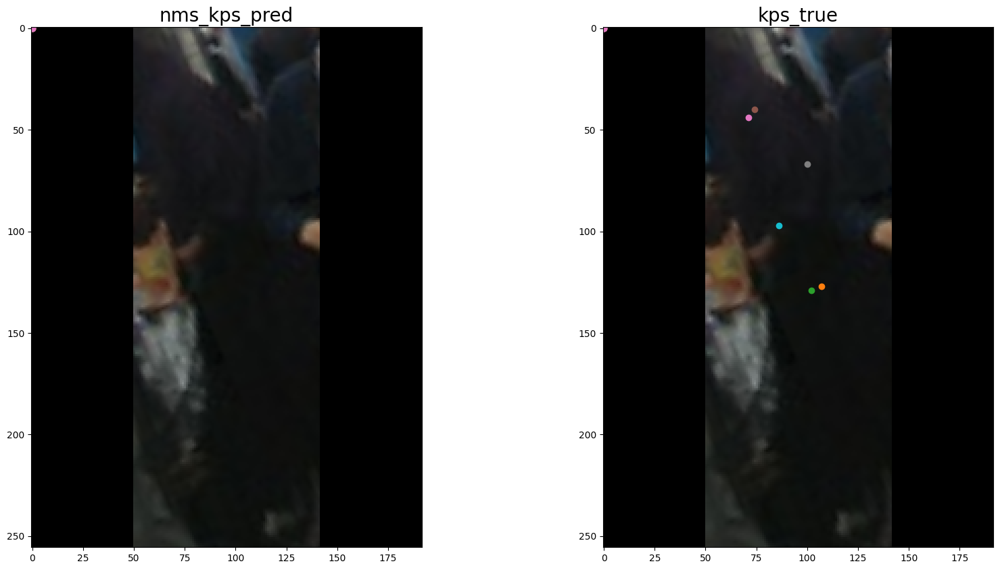

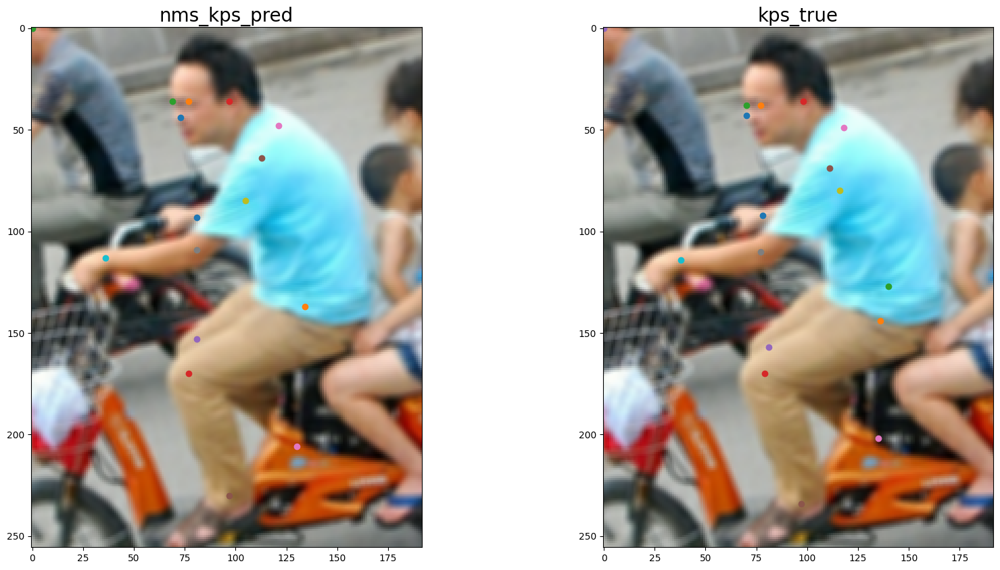

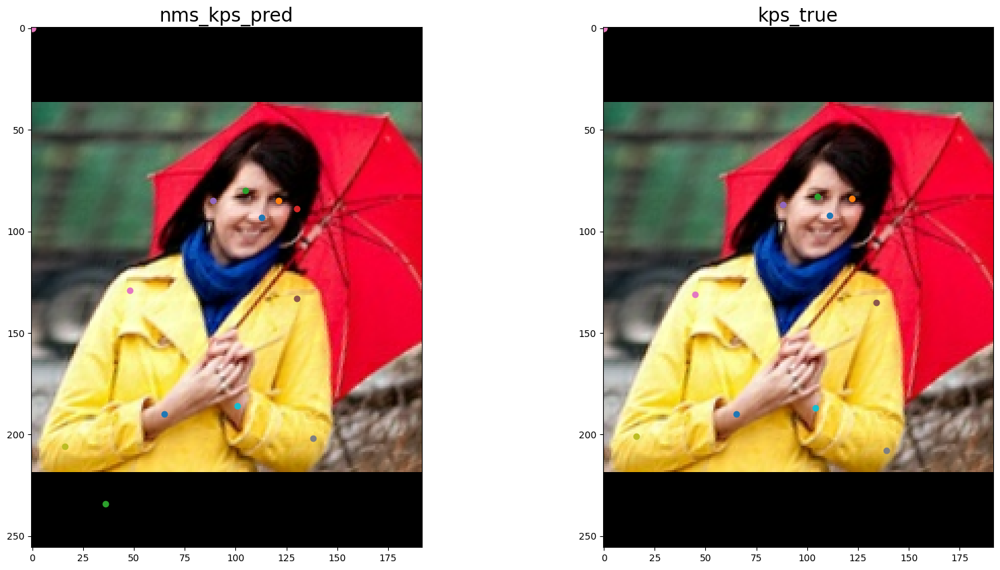

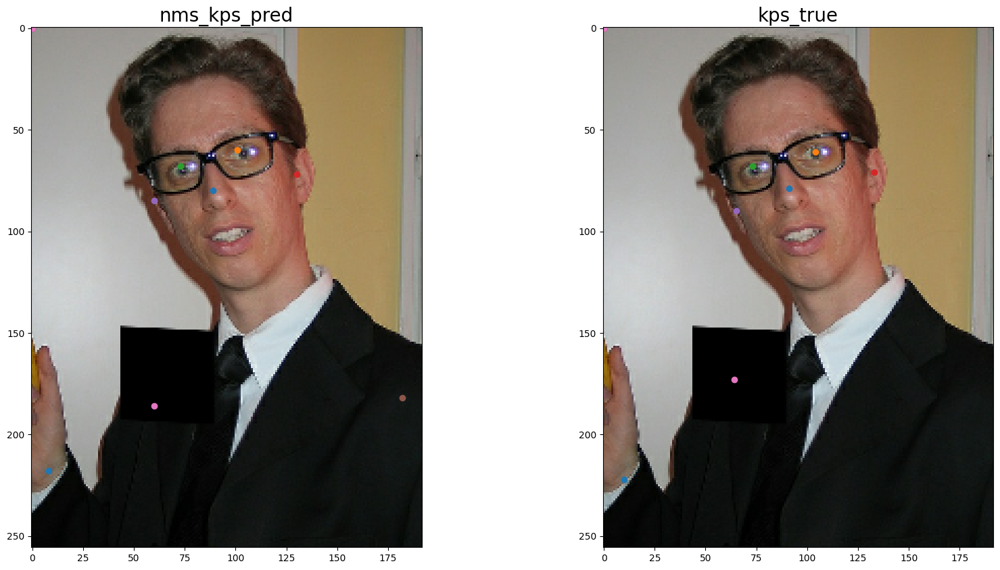

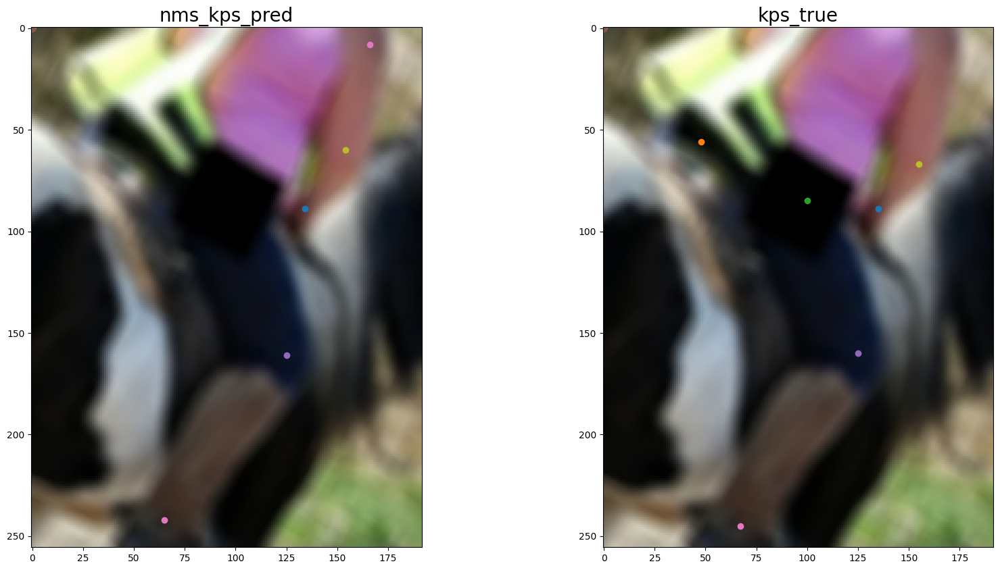

In [10]:
batch_dataset = batch_train_dataset # batch_val_dataset / batch_train_dataset
batch_id = 8
for data in batch_dataset.take(5):
    print(data.keys())
    batch_images = data['image']
    kps_trues = data['kps']
    #hm_trues = data['y_true']
    kps_preds = model.predict(batch_images)

    plt.figure(figsize=(20,10))
    'plot pred kps'
    plt.subplot(1,2,1)
    plt.title('nms_kps_pred',fontsize= 20)
    for i in range(0,17):
        kps_x = int((kps_preds[batch_id,i,0]))
        kps_y = int((kps_preds[batch_id,i,1]))
        plt.scatter(kps_x,kps_y) 
    plt.imshow(batch_images[batch_id,:,:,:])

    plt.subplot(1,2,2)
    plt.title('kps_true',fontsize= 20)
    for i in range(0,17):
        kps_x = int((kps_trues[batch_id,i,0]))
        kps_y = int((kps_trues[batch_id,i,1]))   
        plt.scatter(kps_x,kps_y)  
    plt.imshow(batch_images[batch_id,:,:,:])




dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format', 'y_true', 'sample_weight'])
dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format', 'y_true', 'sample_weight'])
dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format', 'y_true', 'sample_weight'])
dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format', 'y_true', 'sample_weight'])
dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format', 'y_true', 'sample_weight'])


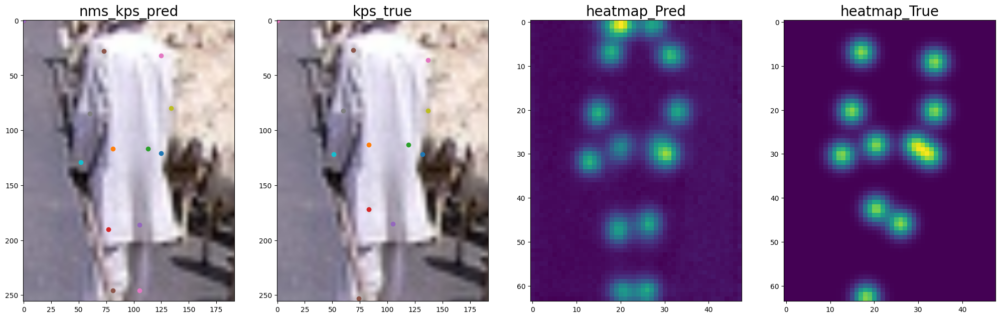

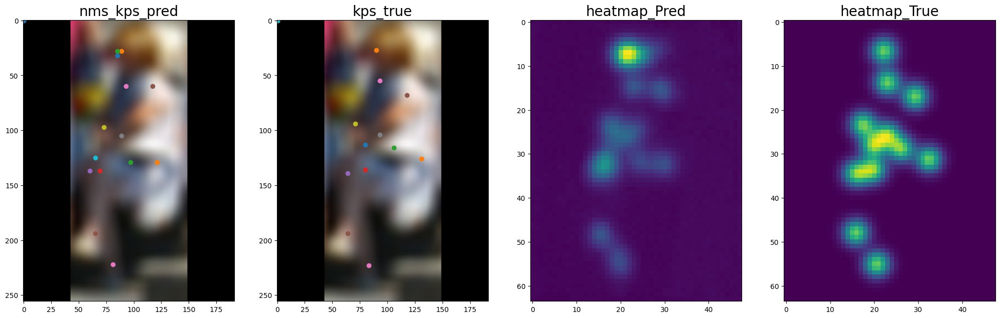

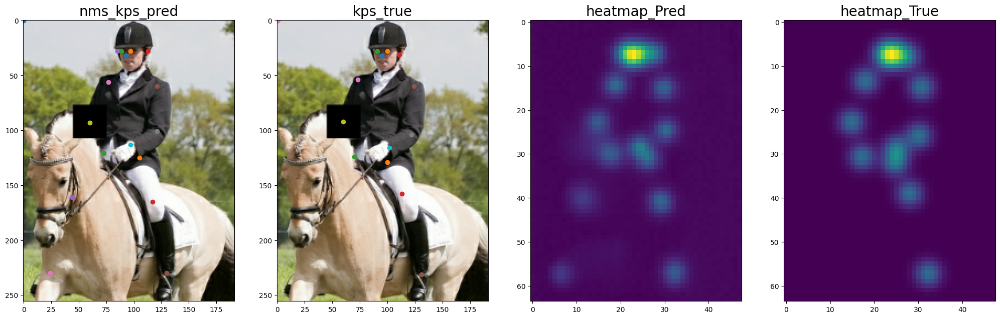

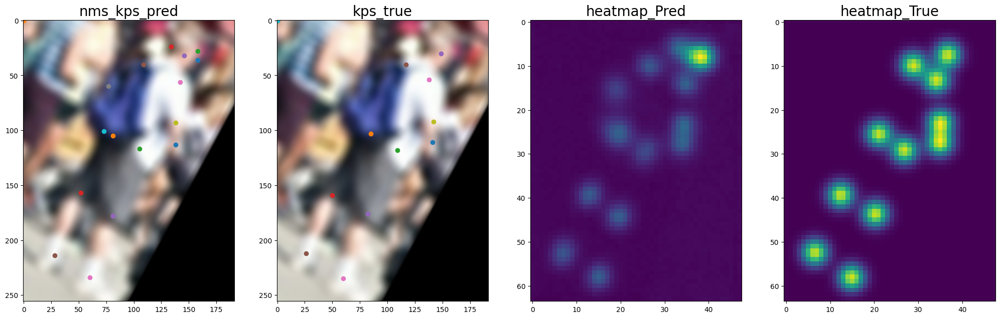

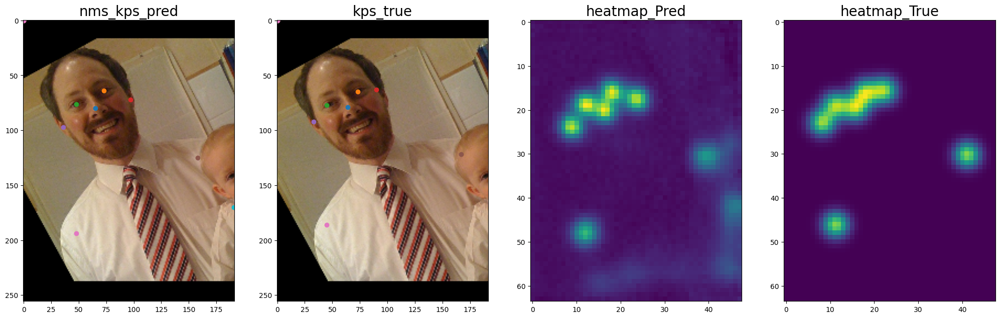

In [9]:
model.codec.hm_thr = tf.concat(
    [tf.ones(shape=(5,), dtype=tf.float32)*0.75, tf.ones(shape=(12,), dtype=tf.float32)*0.35], 
    axis=-1
)

batch_dataset = batch_train_dataset # batch_val_dataset / batch_train_dataset
batch_id = 8
for data in batch_dataset.take(5):
    batch_images = data['image']
    data = model.codec.batch_encode(data)
    print(data.keys())

    kps_trues = data['kps']
    hm_trues = data['y_true']
    hm_preds = model(batch_images)
    kps_preds = model.codec.batch_decode(hm_preds)
    #kps_preds, hm_preds = model.predict(batch_images, with_model_preds=True)

    plt.figure(figsize=(25,10))
    'plot pred kps'
    plt.subplot(1,4,1)
    plt.title('nms_kps_pred',fontsize= 20)
    for i in range(0,17):
        kps_x = int((kps_preds[batch_id,i,0]))
        kps_y = int((kps_preds[batch_id,i,1]))
        plt.scatter(kps_x,kps_y) 
    plt.imshow(batch_images[batch_id,:,:,:])

    plt.subplot(1,4,2)
    plt.title('kps_true',fontsize= 20)
    for i in range(0,17):
        kps_x = int((kps_trues[batch_id,i,0]))
        kps_y = int((kps_trues[batch_id,i,1]))   
        plt.scatter(kps_x,kps_y)  
    plt.imshow(batch_images[batch_id,:,:,:])

    plt.subplot(1,4,3)
    plt.title('heatmap_Pred',fontsize= 20)
    heatmaps_pred = np.array(tf.math.exp(hm_preds[batch_id,:, :, :]))
    plt.imshow(heatmaps_pred.sum(axis=2))

    plt.subplot(1,4,4)
    plt.title('heatmap_True',fontsize= 20)
    heatmaps_true = np.array(hm_trues[batch_id,:, :, :])
    plt.imshow(heatmaps_true.sum(axis=2))
